!pip install --upgrade transformers

In [3]:
from torch.utils.data import Dataset, DataLoader
from transformers import AdamW
import torch
from torch import nn
from sklearn.metrics import accuracy_score
from tqdm.notebook import tqdm
import os
from PIL import Image
from transformers import SegformerForSemanticSegmentation, SegformerFeatureExtractor
import pandas as pd
import cv2
import numpy as np
import albumentations as aug
import matplotlib.pyplot as plt

In [4]:
WIDTH = 512
HEIGHT = 512

In [5]:
class ImageSegmentationDataset(Dataset):
    """Image segmentation dataset."""

    def __init__(self, root_dir, feature_extractor, transforms=None, train=True):
        """
        Args:
            root_dir (string): Root directory of the dataset containing the images + annotations.
            feature_extractor (SegFormerFeatureExtractor): feature extractor to prepare images + segmentation maps.
            train (bool): Whether to load "training" or "validation" images + annotations.
        """
        self.root_dir = root_dir
        self.feature_extractor = feature_extractor
        self.train = train
        self.transforms = transforms

        sub_path = "train" if self.train else "test"
        self.img_dir = os.path.join(self.root_dir, "JPEGImages")
        self.ann_dir = os.path.join(self.root_dir, "SegmentationClassPNG")
        
        # read images
        image_file_names = []
        for root, dirs, files in os.walk(self.img_dir):
            image_file_names.extend(files)
        self.images = sorted(image_file_names)
        
        # read annotations
        annotation_file_names = []
        for root, dirs, files in os.walk(self.ann_dir):
            annotation_file_names.extend(files)
        self.annotations = sorted(annotation_file_names)

        assert len(self.images) == len(self.annotations), "There must be as many images as there are segmentation maps"

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        
        image = cv2.imread(os.path.join(self.img_dir, self.images[idx]))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
#         segmentation_map = cv2.imread(os.path.join(self.ann_dir, self.annotations[idx]))
#         segmentation_map = cv2.cvtColor(segmentation_map, cv2.COLOR_BGR2GRAY)
        segmentation_map = Image.open(os.path.join(self.ann_dir, self.annotations[idx]))
        segmentation_map = np.array(segmentation_map)
        
#         image = Image.open()
#         segmentation_map = Image.open()

        if self.transforms is not None:
            augmented = self.transforms(image=image, mask=segmentation_map)
            # randomly crop + pad both image and segmentation map to same size
            encoded_inputs = self.feature_extractor(augmented['image'], augmented['mask'], return_tensors="pt")
        else:
            encoded_inputs = self.feature_extractor(image, segmentation_map, return_tensors="pt")

        for k,v in encoded_inputs.items():
            encoded_inputs[k].squeeze_() # remove batch dimension

        return encoded_inputs

In [6]:
transform = aug.Compose([
    aug.Flip(p=0.5)
])

In [7]:
# root_dir = '../data/SHI/labelme_format/data_dataset_voc/'
root_dir = '/home/gang/바탕화면/GA2023/labelme_format/data_dataset_voc'
feature_extractor = SegformerFeatureExtractor(align=False, reduce_zero_label=False)

train_dataset = ImageSegmentationDataset(root_dir=root_dir, feature_extractor=feature_extractor, transforms=transform)
valid_dataset = ImageSegmentationDataset(root_dir=root_dir, feature_extractor=feature_extractor, transforms=None, train=False)

/home/gang/anaconda3/envs/openmmlab/lib/python3.8/site-packages/transformers/models/segformer/feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(


In [8]:
print("Number of training examples:", len(train_dataset))
print("Number of validation examples:", len(valid_dataset))

Number of training examples: 47
Number of validation examples: 47


In [9]:
encoded_inputs = train_dataset[1]

In [10]:
encoded_inputs["pixel_values"].shape

torch.Size([3, 512, 512])

In [11]:
encoded_inputs["labels"].shape

torch.Size([512, 512])

In [12]:
encoded_inputs["labels"]

tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 3, 3, 0],
        [0, 0, 0,  ..., 3, 3, 0],
        ...,
        [0, 0, 0,  ..., 3, 3, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]])

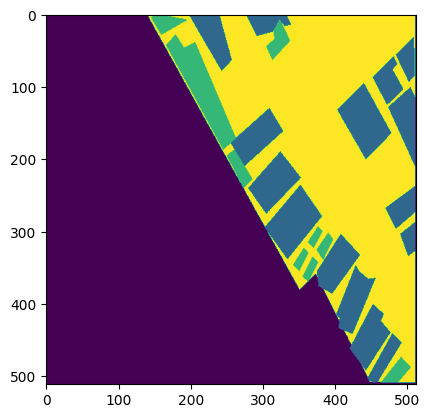

In [13]:
encoded_inputs["labels"].squeeze().unique()
mask = encoded_inputs["labels"].numpy()
plt.imshow(mask)

In [14]:
from torch.utils.data import DataLoader

train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True)
valid_dataloader = DataLoader(valid_dataset, batch_size=4)

In [15]:
batch = next(iter(train_dataloader))

In [16]:
for k,v in batch.items():
    print(k, v.shape)

pixel_values torch.Size([4, 3, 512, 512])
labels torch.Size([4, 512, 512])


In [17]:
batch["labels"].shape

torch.Size([4, 512, 512])

In [18]:
classes = pd.read_csv('/home/gang/바탕화면/GA2023/labelme_format/class_dict.csv')['name']
id2label = classes.to_dict()
label2id = {v: k for k, v in id2label.items()}

In [63]:
model = SegformerForSemanticSegmentation.from_pretrained("nvidia/mit-b3", ignore_mismatched_sizes=True,
                                                         num_labels=len(id2label), id2label=id2label, label2id=label2id,
                                                         reshape_last_stage=True)

Some weights of the model checkpoint at nvidia/mit-b3 were not used when initializing SegformerForSemanticSegmentation: ['classifier.bias', 'classifier.weight']
- This IS expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/mit-b3 and are newly initialized: ['decode_head.linear_c.2.proj.bias', 'decode_head.linear_c.0.proj.weight', 'decode_head.batch_norm.weight', 'decode_head.batch_norm.bias', 'decode_head.linear_c.2.proj.weight', 'decode_head.linear_fus

In [64]:
optimizer = AdamW(model.parameters(), lr=0.00006)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
print("Model Initialized!")

Model Initialized!


/home/gang/anaconda3/envs/openmmlab/lib/python3.8/site-packages/transformers/optimization.py:411: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


In [65]:
for epoch in range(1, 101):  # loop over the dataset multiple times
    print("Epoch:", epoch)
    pbar = tqdm(train_dataloader)
    accuracies = []
    losses = []
    val_accuracies = []
    val_losses = []
    model.train()
    for idx, batch in enumerate(pbar):
        # get the inputs;
        pixel_values = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward
        outputs = model(pixel_values=pixel_values, labels=labels)

        # evaluate
        upsampled_logits = nn.functional.interpolate(outputs.logits, size=labels.shape[-2:], mode="bilinear", align_corners=False)
        predicted = upsampled_logits.argmax(dim=1)

        mask = (labels != 255) # we don't include the background class in the accuracy calculation
        pred_labels = predicted[mask].detach().cpu().numpy()
        true_labels = labels[mask].detach().cpu().numpy()
        accuracy = accuracy_score(pred_labels, true_labels)
        loss = outputs.loss
        accuracies.append(accuracy)
        losses.append(loss.item())
        pbar.set_postfix({'Batch': idx, 'Pixel-wise accuracy': sum(accuracies)/len(accuracies), 'Loss': sum(losses)/len(losses)})

        # backward + optimize
        loss.backward()
        optimizer.step()
    else:
        model.eval()
        with torch.no_grad():
            for idx, batch in enumerate(valid_dataloader):
                pixel_values = batch["pixel_values"].to(device)
                labels = batch["labels"].to(device)

                outputs = model(pixel_values=pixel_values, labels=labels)
                upsampled_logits = nn.functional.interpolate(outputs.logits, size=labels.shape[-2:], mode="bilinear", align_corners=False)
                predicted = upsampled_logits.argmax(dim=1)

                mask = (labels != 255) # we don't include the background class in the accuracy calculation
                pred_labels = predicted[mask].detach().cpu().numpy()
                true_labels = labels[mask].detach().cpu().numpy()
                accuracy = accuracy_score(pred_labels, true_labels)
                val_loss = outputs.loss
                val_accuracies.append(accuracy)
                val_losses.append(val_loss.item())

    print(f"Train Pixel-wise accuracy: {sum(accuracies)/len(accuracies)}\
         Train Loss: {sum(losses)/len(losses)}\
         Val Pixel-wise accuracy: {sum(val_accuracies)/len(val_accuracies)}\
         Val Loss: {sum(val_losses)/len(val_losses)}")
     

Epoch: 1


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.5536162853240967         Train Loss: 1.0714831749598186         Val Pixel-wise accuracy: 0.7921405633290609         Val Loss: 0.8839096625645956
Epoch: 2


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.7879499594370524         Train Loss: 0.6274118075768153         Val Pixel-wise accuracy: 0.8266459835900201         Val Loss: 0.5215123097101847
Epoch: 3


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.8419347339206271         Train Loss: 0.46506909529368085         Val Pixel-wise accuracy: 0.8752403259277344         Val Loss: 0.37275448193152744
Epoch: 4


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.8572926786210803         Train Loss: 0.42031798263390857         Val Pixel-wise accuracy: 0.8870945241716174         Val Loss: 0.3246657612423102
Epoch: 5


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.8777520921495227         Train Loss: 0.35307955493529636         Val Pixel-wise accuracy: 0.897633605533176         Val Loss: 0.2921472204228242
Epoch: 6


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.8855410681830512         Train Loss: 0.3460918354491393         Val Pixel-wise accuracy: 0.9069809648725721         Val Loss: 0.25783704842130345
Epoch: 7


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.8918264177110461         Train Loss: 0.3100157131751378         Val Pixel-wise accuracy: 0.9137114418877496         Val Loss: 0.23697594366967678
Epoch: 8


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.905908081266615         Train Loss: 0.27519118910034496         Val Pixel-wise accuracy: 0.9185840553707547         Val Loss: 0.2209203951060772
Epoch: 9


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9009771347045898         Train Loss: 0.2814747331043084         Val Pixel-wise accuracy: 0.9242486688825818         Val Loss: 0.2072551300128301
Epoch: 10


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9111644426981608         Train Loss: 0.25405964627861977         Val Pixel-wise accuracy: 0.9290602737002902         Val Loss: 0.19526940522094569
Epoch: 11


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9209727181328667         Train Loss: 0.22660874823729196         Val Pixel-wise accuracy: 0.9324754344092475         Val Loss: 0.18427779525518417
Epoch: 12


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9255207379659017         Train Loss: 0.21287841722369194         Val Pixel-wise accuracy: 0.9361741012997098         Val Loss: 0.1745236317316691
Epoch: 13


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9265765878889295         Train Loss: 0.20868183424075445         Val Pixel-wise accuracy: 0.939492252137926         Val Loss: 0.1667584658910831
Epoch: 14


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9285906950632731         Train Loss: 0.20212960739930472         Val Pixel-wise accuracy: 0.9382345146603055         Val Loss: 0.1698029680798451
Epoch: 15


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9312530358632406         Train Loss: 0.18888350451985994         Val Pixel-wise accuracy: 0.9330069488949246         Val Loss: 0.18171214684844017
Epoch: 16


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9299278789096408         Train Loss: 0.19601019968589148         Val Pixel-wise accuracy: 0.934134324391683         Val Loss: 0.1754551474004984
Epoch: 17


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9286950694190131         Train Loss: 0.20233560105164847         Val Pixel-wise accuracy: 0.9407356845008003         Val Loss: 0.15997494757175446
Epoch: 18


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9351555241478814         Train Loss: 0.1844794899225235         Val Pixel-wise accuracy: 0.9448146555158826         Val Loss: 0.15043130392829576
Epoch: 19


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9356310632493762         Train Loss: 0.1823738639553388         Val Pixel-wise accuracy: 0.9450150595770942         Val Loss: 0.14813995795945326
Epoch: 20


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9356511433919271         Train Loss: 0.18380633741617203         Val Pixel-wise accuracy: 0.9456126425001355         Val Loss: 0.1473717326298356
Epoch: 21


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9384507868025037         Train Loss: 0.17334173619747162         Val Pixel-wise accuracy: 0.9459670119815402         Val Loss: 0.14676904616256556
Epoch: 22


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.935832526948717         Train Loss: 0.17868535034358501         Val Pixel-wise accuracy: 0.9462490611606174         Val Loss: 0.14608913535873094
Epoch: 23


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9381994406382242         Train Loss: 0.17077774306138357         Val Pixel-wise accuracy: 0.9488790565066867         Val Loss: 0.13588830859710774
Epoch: 24


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9405120743645562         Train Loss: 0.16606435179710388         Val Pixel-wise accuracy: 0.9501729276445178         Val Loss: 0.1335248677060008
Epoch: 25


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.936564392513699         Train Loss: 0.1755740356942018         Val Pixel-wise accuracy: 0.9499487347073026         Val Loss: 0.13708622256914774
Epoch: 26


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9441727267371284         Train Loss: 0.1553839681049188         Val Pixel-wise accuracy: 0.9522595405578613         Val Loss: 0.1282372052470843
Epoch: 27


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9477387269337972         Train Loss: 0.145083570231994         Val Pixel-wise accuracy: 0.9538042015499539         Val Loss: 0.12418804162492354
Epoch: 28


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9434797763824463         Train Loss: 0.15885201717416444         Val Pixel-wise accuracy: 0.9531842072804769         Val Loss: 0.12417077894012134
Epoch: 29


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9452154106563992         Train Loss: 0.15440461970865726         Val Pixel-wise accuracy: 0.954095893436008         Val Loss: 0.12171855196356773
Epoch: 30


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.949967278374566         Train Loss: 0.13846192136406898         Val Pixel-wise accuracy: 0.9557189146677653         Val Loss: 0.11886455739537875
Epoch: 31


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9495775169796414         Train Loss: 0.14011426704625288         Val Pixel-wise accuracy: 0.9565796057383219         Val Loss: 0.11604951228946447
Epoch: 32


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9527158737182617         Train Loss: 0.1287703967342774         Val Pixel-wise accuracy: 0.957699696222941         Val Loss: 0.11283979037155707
Epoch: 33


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9506855275895861         Train Loss: 0.13601281866431236         Val Pixel-wise accuracy: 0.9568598535325793         Val Loss: 0.11345917234818141
Epoch: 34


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9524776140848795         Train Loss: 0.1317456097652515         Val Pixel-wise accuracy: 0.9572087658776177         Val Loss: 0.11270972962180774
Epoch: 35


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9532734553019205         Train Loss: 0.12681342102587223         Val Pixel-wise accuracy: 0.9590193430582682         Val Loss: 0.10887119205047686
Epoch: 36


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9517242378658719         Train Loss: 0.13768802086512247         Val Pixel-wise accuracy: 0.9590018590291342         Val Loss: 0.1080517362182339
Epoch: 37


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9543982876671685         Train Loss: 0.12483132878939311         Val Pixel-wise accuracy: 0.9588613245222303         Val Loss: 0.10829189450790484
Epoch: 38


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9541819095611572         Train Loss: 0.12505138913790384         Val Pixel-wise accuracy: 0.9598230520884196         Val Loss: 0.10597045409182708
Epoch: 39


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9532411628299289         Train Loss: 0.12653636311491331         Val Pixel-wise accuracy: 0.9593864017062717         Val Loss: 0.10644479903082053
Epoch: 40


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9513275623321533         Train Loss: 0.13043655517200628         Val Pixel-wise accuracy: 0.9592181311713325         Val Loss: 0.10643121724327405
Epoch: 41


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9529169135623508         Train Loss: 0.12586909408370653         Val Pixel-wise accuracy: 0.9576707681020101         Val Loss: 0.11083545535802841
Epoch: 42


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.953667508231269         Train Loss: 0.12508160310486952         Val Pixel-wise accuracy: 0.960341215133667         Val Loss: 0.10435166334112485
Epoch: 43


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9539939562479655         Train Loss: 0.1259151343256235         Val Pixel-wise accuracy: 0.9591211742824979         Val Loss: 0.10649609379470348
Epoch: 44


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9549122386508517         Train Loss: 0.12229208399852116         Val Pixel-wise accuracy: 0.9610017670525445         Val Loss: 0.10247866623103619
Epoch: 45


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9561136033799914         Train Loss: 0.1181272491812706         Val Pixel-wise accuracy: 0.961053556866116         Val Loss: 0.10155070138474305
Epoch: 46


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9560879601372613         Train Loss: 0.11950584314763546         Val Pixel-wise accuracy: 0.9621206919352213         Val Loss: 0.0984469602505366
Epoch: 47


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.958643012576633         Train Loss: 0.11360362234214942         Val Pixel-wise accuracy: 0.9622847768995496         Val Loss: 0.09849065418044727
Epoch: 48


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.959175189336141         Train Loss: 0.10808059635261695         Val Pixel-wise accuracy: 0.9631282753414578         Val Loss: 0.09592738499244054
Epoch: 49


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9586157004038492         Train Loss: 0.11284745795031388         Val Pixel-wise accuracy: 0.9626764721340604         Val Loss: 0.09696659073233604
Epoch: 50


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9585898717244467         Train Loss: 0.11217934638261795         Val Pixel-wise accuracy: 0.9629076851738824         Val Loss: 0.09570272173732519
Epoch: 51


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9582101504007975         Train Loss: 0.11393038307627042         Val Pixel-wise accuracy: 0.9627892176310221         Val Loss: 0.09669380510846774
Epoch: 52


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9602756500244141         Train Loss: 0.10752763723333676         Val Pixel-wise accuracy: 0.9642944865756564         Val Loss: 0.09275835535178582
Epoch: 53


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9545968108707004         Train Loss: 0.12227058410644531         Val Pixel-wise accuracy: 0.9636256694793701         Val Loss: 0.09415283209333818
Epoch: 54


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9544923570421008         Train Loss: 0.1285604735215505         Val Pixel-wise accuracy: 0.9571911758846707         Val Loss: 0.10974122490733862
Epoch: 55


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9516977998945447         Train Loss: 0.1309337013711532         Val Pixel-wise accuracy: 0.9603601296742758         Val Loss: 0.10167844220995903
Epoch: 56


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9553999900817871         Train Loss: 0.11805593098203342         Val Pixel-wise accuracy: 0.9568900002373589         Val Loss: 0.1114346810306112
Epoch: 57


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.955340200000339         Train Loss: 0.12131177385648091         Val Pixel-wise accuracy: 0.9621790250142416         Val Loss: 0.09752059572686751
Epoch: 58


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9584997759924995         Train Loss: 0.10961475037038326         Val Pixel-wise accuracy: 0.962330526775784         Val Loss: 0.09692869614809752
Epoch: 59


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9595487382676867         Train Loss: 0.10910697219272454         Val Pixel-wise accuracy: 0.9640200932820638         Val Loss: 0.09275422679881255
Epoch: 60


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9593494468265109         Train Loss: 0.10685159265995026         Val Pixel-wise accuracy: 0.9650277826521131         Val Loss: 0.09037157769004504
Epoch: 61


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9601913028293185         Train Loss: 0.10398660072435935         Val Pixel-wise accuracy: 0.9649628533257378         Val Loss: 0.09053557319566607
Epoch: 62


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9610581133100721         Train Loss: 0.10386231231192748         Val Pixel-wise accuracy: 0.9659341706169976         Val Loss: 0.08790774876251817
Epoch: 63


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9608722527821859         Train Loss: 0.10479259490966797         Val Pixel-wise accuracy: 0.9643294281429715         Val Loss: 0.09084849463154872
Epoch: 64


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9608945316738553         Train Loss: 0.10657114846011002         Val Pixel-wise accuracy: 0.9653793970743815         Val Loss: 0.0884693522627155
Epoch: 65


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9613977803124322         Train Loss: 0.10263897043963273         Val Pixel-wise accuracy: 0.9657675160302056         Val Loss: 0.08770527768259247
Epoch: 66


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9630549218919543         Train Loss: 0.09852661471813917         Val Pixel-wise accuracy: 0.9665002293056912         Val Loss: 0.0855850384881099
Epoch: 67


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9601274596320258         Train Loss: 0.10719793227811654         Val Pixel-wise accuracy: 0.9660229682922363         Val Loss: 0.0864737977584203
Epoch: 68


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9626332918802897         Train Loss: 0.10082108899950981         Val Pixel-wise accuracy: 0.9670134915245904         Val Loss: 0.08452683469901483
Epoch: 69


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9639357195960151         Train Loss: 0.09607675888886054         Val Pixel-wise accuracy: 0.9677129586537679         Val Loss: 0.08294852900629242
Epoch: 70


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9641962581210666         Train Loss: 0.09379466871420543         Val Pixel-wise accuracy: 0.9678760899437798         Val Loss: 0.08261705345163743
Epoch: 71


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9640987184312609         Train Loss: 0.09573510537544887         Val Pixel-wise accuracy: 0.9663212299346924         Val Loss: 0.08519066963344812
Epoch: 72


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9643067518870035         Train Loss: 0.09337037367125352         Val Pixel-wise accuracy: 0.9681743250952827         Val Loss: 0.08125933880607288
Epoch: 73


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9640279610951742         Train Loss: 0.09576396519939105         Val Pixel-wise accuracy: 0.9674400753445096         Val Loss: 0.08275404681141178
Epoch: 74


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.963243669933743         Train Loss: 0.10011579437802236         Val Pixel-wise accuracy: 0.9668489032321506         Val Loss: 0.08416717872023582
Epoch: 75


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9630652533637153         Train Loss: 0.09843636490404606         Val Pixel-wise accuracy: 0.9682585928175184         Val Loss: 0.08046215229357283
Epoch: 76


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9639342890845405         Train Loss: 0.09525948700805505         Val Pixel-wise accuracy: 0.9686108430226644         Val Loss: 0.08002891546736161
Epoch: 77


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9651234679751926         Train Loss: 0.09151179064065218         Val Pixel-wise accuracy: 0.9688423739539253         Val Loss: 0.07913026679307222
Epoch: 78


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9652905464172363         Train Loss: 0.09071384028842051         Val Pixel-wise accuracy: 0.968452665540907         Val Loss: 0.07989277023201187
Epoch: 79


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9655850198533801         Train Loss: 0.08895812649279833         Val Pixel-wise accuracy: 0.9692659378051758         Val Loss: 0.07798413326963782
Epoch: 80


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9650971359676785         Train Loss: 0.09300986304879189         Val Pixel-wise accuracy: 0.9690083927578397         Val Loss: 0.07832085217038791
Epoch: 81


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9655928081936307         Train Loss: 0.08890928886830807         Val Pixel-wise accuracy: 0.9690626462300619         Val Loss: 0.07814777983973424
Epoch: 82


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.965977668762207         Train Loss: 0.08793163175384204         Val Pixel-wise accuracy: 0.9700074990590414         Val Loss: 0.07613990688696504
Epoch: 83


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9669642978244357         Train Loss: 0.08577057874451081         Val Pixel-wise accuracy: 0.9699338012271457         Val Loss: 0.0762354548399647
Epoch: 84


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9660918447706434         Train Loss: 0.0879691190396746         Val Pixel-wise accuracy: 0.9693296485477023         Val Loss: 0.07756010179097454
Epoch: 85


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9660833146837023         Train Loss: 0.08838166513790686         Val Pixel-wise accuracy: 0.9684065712822808         Val Loss: 0.07930030860006809
Epoch: 86


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9661968019273547         Train Loss: 0.08746336493641138         Val Pixel-wise accuracy: 0.9697989887661405         Val Loss: 0.07606712573518355
Epoch: 87


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.966601292292277         Train Loss: 0.0859212763607502         Val Pixel-wise accuracy: 0.9703081713782417         Val Loss: 0.07491183172290523
Epoch: 88


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9667717880672879         Train Loss: 0.08483156686027844         Val Pixel-wise accuracy: 0.9700544940100776         Val Loss: 0.07548106523851554
Epoch: 89


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9664543204837375         Train Loss: 0.0867640096694231         Val Pixel-wise accuracy: 0.9705632527669271         Val Loss: 0.07418005246048172
Epoch: 90


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9661585224999322         Train Loss: 0.08891293251266082         Val Pixel-wise accuracy: 0.9696797264946831         Val Loss: 0.07590442337095737
Epoch: 91


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.96695876121521         Train Loss: 0.08458634000271559         Val Pixel-wise accuracy: 0.9698424339294434         Val Loss: 0.07554687171553572
Epoch: 92


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9674529764387342         Train Loss: 0.08452890999615192         Val Pixel-wise accuracy: 0.970894972483317         Val Loss: 0.07294289659087856
Epoch: 93


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9677880869971381         Train Loss: 0.082550760358572         Val Pixel-wise accuracy: 0.9709673192765979         Val Loss: 0.07307137145350377
Epoch: 94


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.967241472668118         Train Loss: 0.08477135623494784         Val Pixel-wise accuracy: 0.9707409805721707         Val Loss: 0.0736265101780494
Epoch: 95


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9670649634467231         Train Loss: 0.0847219613691171         Val Pixel-wise accuracy: 0.969947894414266         Val Loss: 0.07482670061290264
Epoch: 96


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9665669865078397         Train Loss: 0.08751878949503104         Val Pixel-wise accuracy: 0.9709380467732748         Val Loss: 0.07252918214847644
Epoch: 97


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9666042592790393         Train Loss: 0.08714688383042812         Val Pixel-wise accuracy: 0.9707920286390516         Val Loss: 0.07286466099321842
Epoch: 98


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9683523972829183         Train Loss: 0.08158311837663253         Val Pixel-wise accuracy: 0.9711931281619601         Val Loss: 0.0720110045125087
Epoch: 99


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9686729378170438         Train Loss: 0.08066331967711449         Val Pixel-wise accuracy: 0.9718230565388998         Val Loss: 0.07044526065389316
Epoch: 100


  0%|          | 0/12 [00:00<?, ?it/s]

Train Pixel-wise accuracy: 0.9680466651916504         Train Loss: 0.08248111326247454         Val Pixel-wise accuracy: 0.9715967973073324         Val Loss: 0.07089376403018832


In [ ]:
'''
mit-b0
epoch: 10
Train Pixel-wise accuracy: 0.8415105077955457
Train Loss: 0.5011238306760788
Val Pixel-wise accuracy: 0.878816737069024
Val Loss: 0.38382398958007496
'''

'''
mit-b1
epoch: 10
Train Pixel-wise accuracy: 0.8822679254743787
Train Loss: 0.4109685520331065
Val Pixel-wise accuracy: 0.9009615580240885
Val Loss: 0.32037703072031337

epoch: 20
Train Pixel-wise accuracy: 0.9053452014923096
Train Loss: 0.3278160144885381
Val Pixel-wise accuracy: 0.9250973065694174
Val Loss: 0.24594590937097868
'''

'''
mit-b2

epoch: 40
Train Pixel-wise accuracy: 0.9436243375142416
Train Loss: 0.15602527745068073
Val Pixel-wise accuracy: 0.9527870814005533
Val Loss: 0.12615240986148515
'''


'''
mit-b3

epoch: 100
Train Pixel-wise accuracy: 0.9680466651916504
Train Loss: 0.08248111326247454
Val Pixel-wise accuracy: 0.9715967973073324
Val Loss: 0.07089376403018832
'''

# Hugging Face Inference

In [66]:
df = pd.read_csv('/home/gang/바탕화면/GA2023/labelme_format/class_dict.csv')
classes = df['name']
palette = df[[' r', ' g', ' b']].values
id2label = classes.to_dict()
label2id = {v: k for k, v in id2label.items()}
     

root_dir = '../data/SHI/labelme_format/data_dataset_voc/'
feature_extractor = SegformerFeatureExtractor(align=False, reduce_zero_label=False)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = SegformerForSemanticSegmentation.from_pretrained("deep-learning-analytics/segformer_semantic_segmentation", ignore_mismatched_sizes=True,
                                                         num_labels=len(id2label), id2label=id2label, label2id=label2id,
                                                         reshape_last_stage=True)
model = model.to(device)

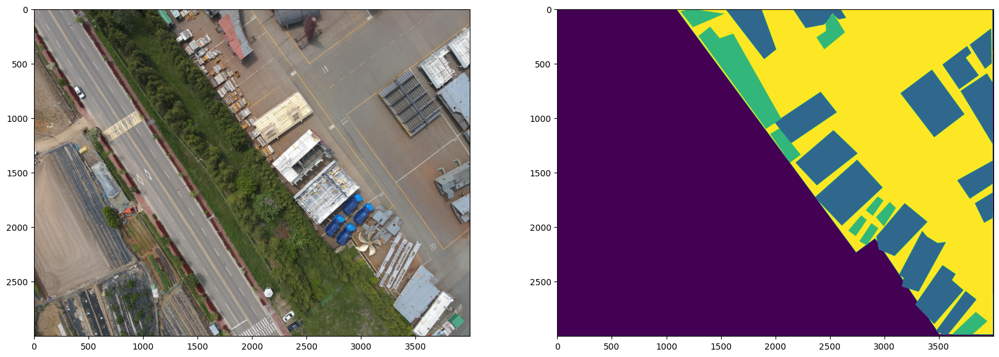

In [67]:
image = Image.open('/home/gang/바탕화면/GA2023/labelme_format/data_dataset_voc/JPEGImages/DJI_20230503104709_0021_W.jpg')
mask = Image.open('/home/gang/바탕화면/GA2023/labelme_format/data_dataset_voc/SegmentationClassPNG/DJI_20230503104709_0021_W.png').convert('L')

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image)
axs[1].imshow(mask)
plt.show()

In [68]:
feature_extractor_inference = SegformerFeatureExtractor(do_random_crop=False, do_pad=False)

pixel_values = feature_extractor_inference(image, return_tensors="pt").pixel_values.to(device)
print(pixel_values.shape)

torch.Size([1, 3, 512, 512])


/home/gang/anaconda3/envs/openmmlab/lib/python3.8/site-packages/transformers/models/segformer/feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(


In [69]:
model.eval()
outputs = model(pixel_values=pixel_values)# logits are of shape (batch_size, num_labels, height/4, width/4)
logits = outputs.logits.cpu()
print(logits.shape)

torch.Size([1, 4, 128, 128])


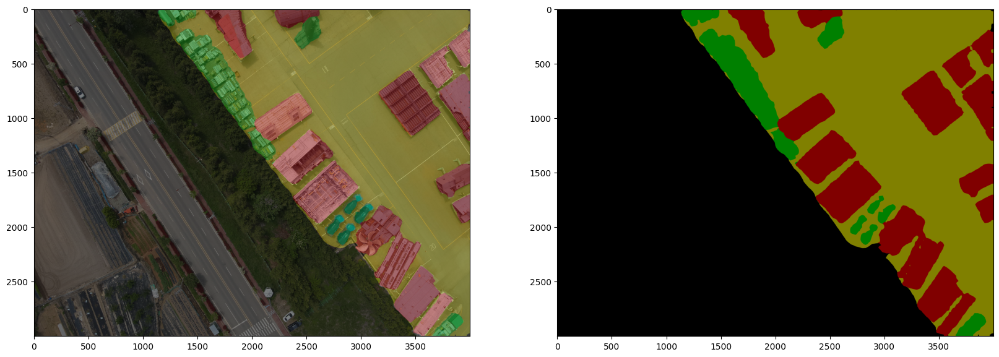

In [70]:
upsampled_logits = nn.functional.interpolate(logits,
                size=image.size[::-1], # (height, width)
                mode='bilinear',
                align_corners=False)

# Second, apply argmax on the class dimension
seg = upsampled_logits.argmax(dim=1)[0]
color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8) # height, width, 3\
for label, color in enumerate(palette):
    color_seg[seg == label, :] = color
# Convert to BGR
color_seg = color_seg[..., ::-1]

# Show image + mask
img = np.array(image) * 0.5 + color_seg * 0.5
img = img.astype(np.uint8)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(img)
axs[1].imshow(color_seg)
plt.show()

In [71]:
image_path = '/home/gang/바탕화면/GA2023/labelme_format/data_dataset_voc/JPEGImages/'
mask_path = '/home/gang/바탕화면/GA2023/labelme_format/data_dataset_voc/SegmentationClassPNG/'
gt_path = '/home/gang/바탕화면/GA2023/labelme_format/data_dataset_voc/SegmentationClassVisualization/'

src_images = os.listdir(image_path)
src_masks = os.listdir(mask_path)
src_gt = os.listdir(gt_path)

src_images.sort()
src_masks.sort()
src_gt.sort()

/tmp/ipykernel_18797/2230473718.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, 3, figsize=(20, 10))


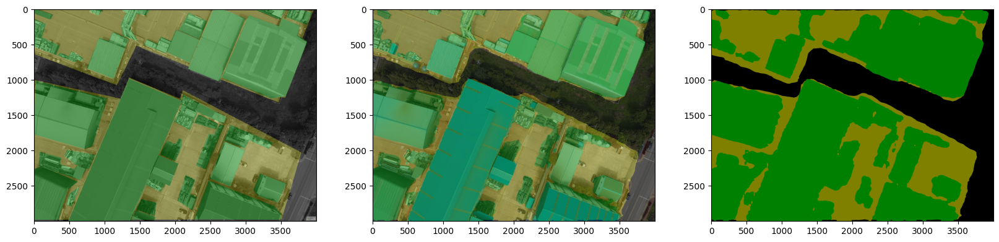

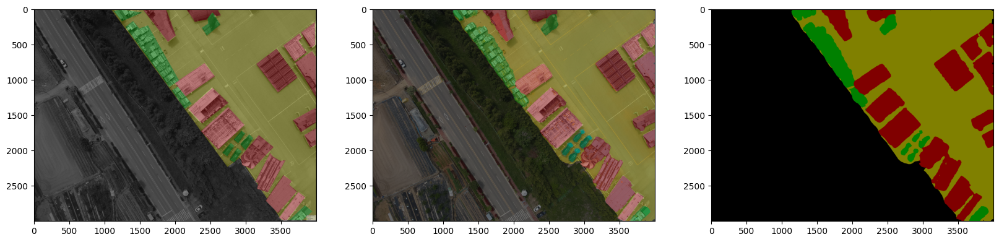

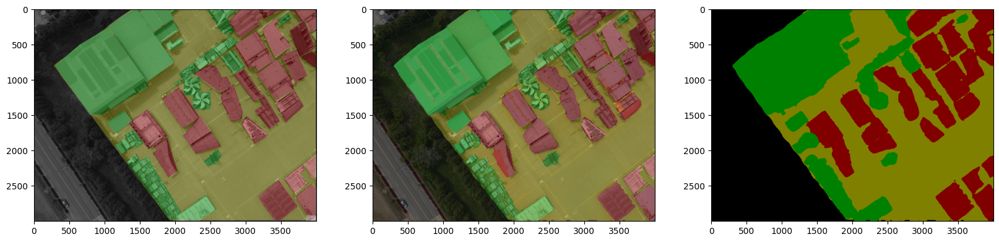

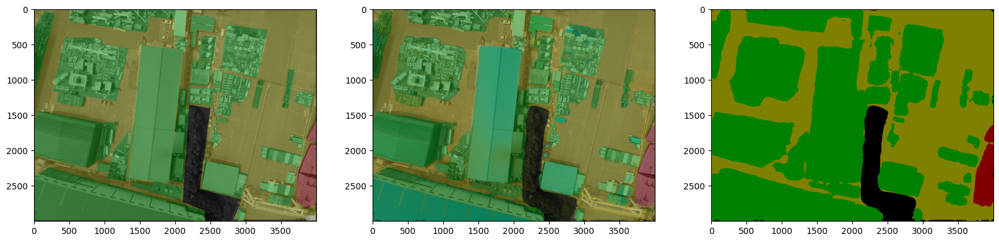

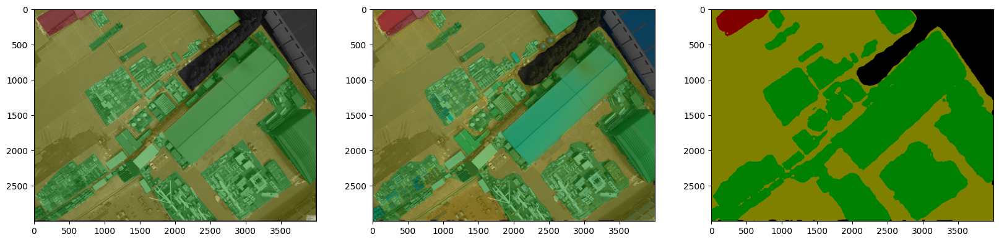

...

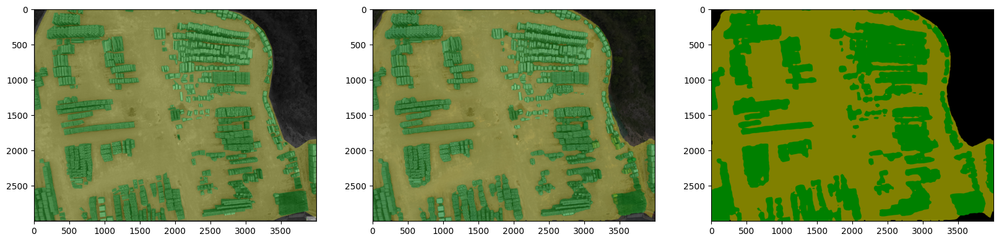

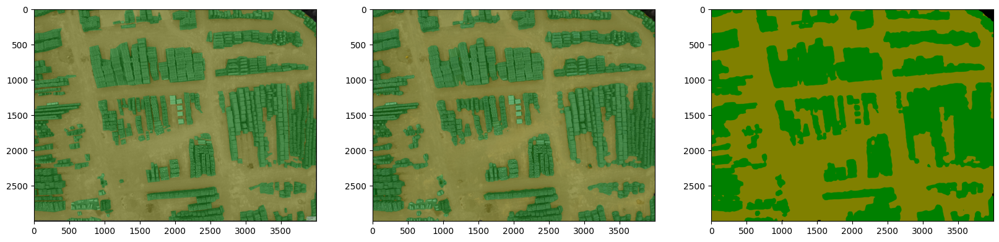

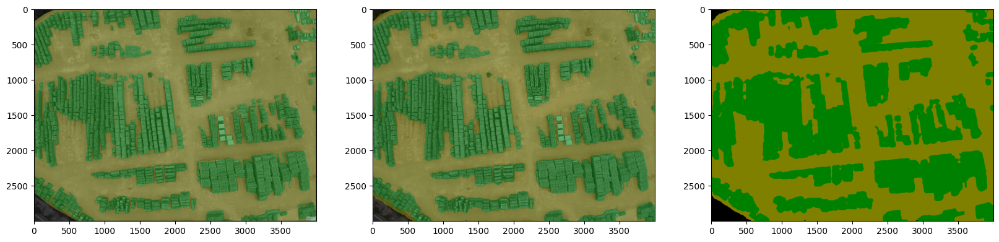

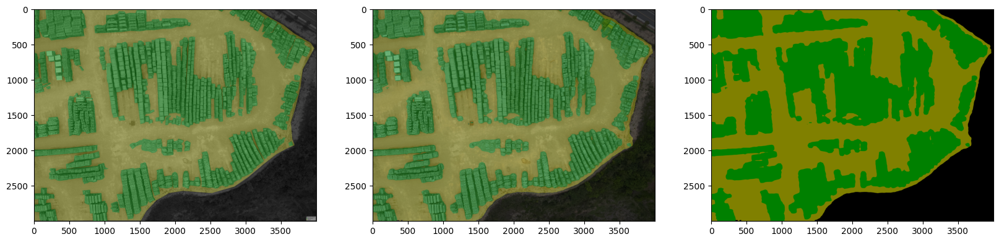

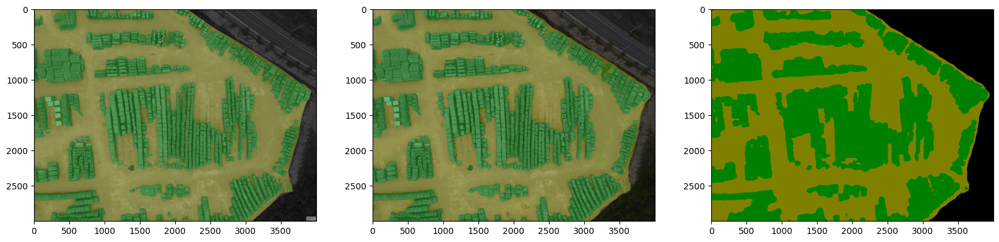

In [74]:
for img, mask, gt in zip(src_images, src_masks, src_gt):
    image_img = Image.open(image_path + img)
    mask_img = Image.open(mask_path + mask).convert('L')
    gt_img = Image.open(gt_path + gt)
    
    feature_extractor_inference = SegformerFeatureExtractor(do_random_crop=False, do_pad=False)

    pixel_values = feature_extractor_inference(image_img, return_tensors="pt").pixel_values.to(device)
    
    model.eval()
    outputs = model(pixel_values=pixel_values)# logits are of shape (batch_size, num_labels, height/4, width/4)
    logits = outputs.logits.cpu()
    
    upsampled_logits = nn.functional.interpolate(logits,
                size=image_img.size[::-1], # (height, width)
                mode='bilinear',
                align_corners=False)

    # Second, apply argmax on the class dimension
    seg = upsampled_logits.argmax(dim=1)[0]
    color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8) # height, width, 3\
    for label, color in enumerate(palette):
        color_seg[seg == label, :] = color
    # Convert to BGR
    color_seg = color_seg[..., ::-1]

    # Show image + mask
    img = np.array(image_img) * 0.5 + color_seg * 0.5
    img = img.astype(np.uint8)

    fig, axs = plt.subplots(1, 3, figsize=(20, 10))
    axs[0].imshow(gt_img)
    axs[1].imshow(img)
    axs[2].imshow(color_seg)

    plt.savefig('./labelme_format/SegFormer_result/b3_epoch_100/'+mask, pad_inches=0)

MASK 없는 데이터

/home/gang/anaconda3/envs/openmmlab/lib/python3.8/site-packages/transformers/models/segformer/feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(


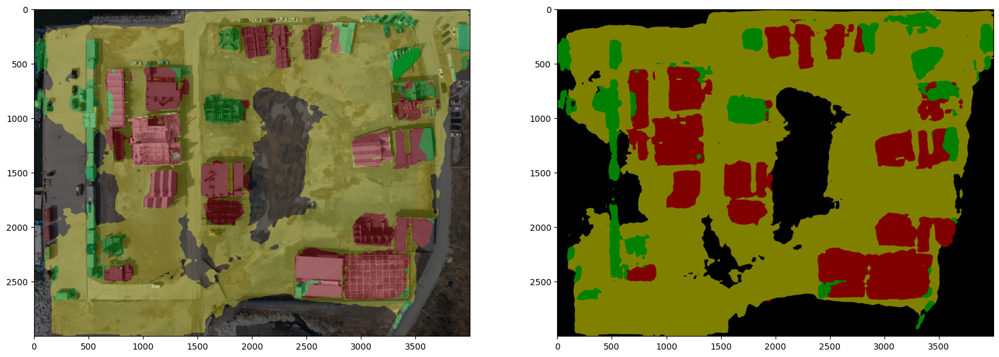

In [75]:
test_path = '/home/gang/바탕화면/GA2023/labelme_format/nomask/DJI_20230222132041_0001_W.JPG'

test_img = Image.open(test_path)


feature_extractor_inference = SegformerFeatureExtractor(do_random_crop=False, do_pad=False)

pixel_values = feature_extractor_inference(test_img, return_tensors="pt").pixel_values.to(device)

model.eval()
outputs = model(pixel_values=pixel_values)# logits are of shape (batch_size, num_labels, height/4, width/4)
logits = outputs.logits.cpu()

upsampled_logits = nn.functional.interpolate(logits,
            size=test_img.size[::-1], # (height, width)
            mode='bilinear',
            align_corners=False)

# Second, apply argmax on the class dimension
seg = upsampled_logits.argmax(dim=1)[0]
color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8) # height, width, 3\
for label, color in enumerate(palette):
    color_seg[seg == label, :] = color
# Convert to BGR
color_seg = color_seg[..., ::-1]

# Show image + mask
img = np.array(test_img) * 0.5 + color_seg * 0.5
img = img.astype(np.uint8)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
# axs[0].imshow(gt_img)
axs[0].imshow(img)
axs[1].imshow(color_seg)

plt.savefig('./labelme_format/test_result/nomask/'+'b3_epoch_100_'+'DJI_20230222132041_0001_W.JPG', pad_inches=0)

/home/gang/anaconda3/envs/openmmlab/lib/python3.8/site-packages/transformers/models/segformer/feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(


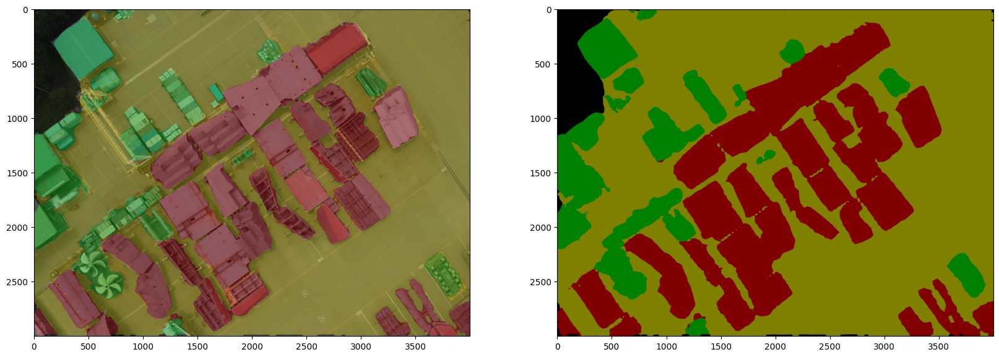

In [76]:
test_path = '/home/gang/바탕화면/GA2023/labelme_format/nomask/DJI_20230503104849_0060_W.JPG'

test_img = Image.open(test_path)


feature_extractor_inference = SegformerFeatureExtractor(do_random_crop=False, do_pad=False)

pixel_values = feature_extractor_inference(test_img, return_tensors="pt").pixel_values.to(device)

model.eval()
outputs = model(pixel_values=pixel_values)# logits are of shape (batch_size, num_labels, height/4, width/4)
logits = outputs.logits.cpu()

upsampled_logits = nn.functional.interpolate(logits,
            size=test_img.size[::-1], # (height, width)
            mode='bilinear',
            align_corners=False)

# Second, apply argmax on the class dimension
seg = upsampled_logits.argmax(dim=1)[0]
color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8) # height, width, 3\
for label, color in enumerate(palette):
    color_seg[seg == label, :] = color
# Convert to BGR
color_seg = color_seg[..., ::-1]

# Show image + mask
img = np.array(test_img) * 0.5 + color_seg * 0.5
img = img.astype(np.uint8)

fig, axs = plt.subplots(1, 2, figsize=(20, 10))
# axs[0].imshow(gt_img)
axs[0].imshow(img)
axs[1].imshow(color_seg)

plt.savefig('./labelme_format/test_result/nomask/'+'b3_epoch_100_'+'DJI_20230503104849_0060_W.JPG', pad_inches=0)